## Data Preprocessing

○ Handle missing data through imputation or removal (e.g., mean imputation, mode imputation, dropping rows).

○ Address outliers using statistical methods or domain knowledge (e.g., z-score thresholding, interquartile range).

○ Normalize or scale features as needed for analysis (e.g., Min-Max scaling, standardization).

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
#mount the drive
from google.colab import drive
drive.mount('/content/drive')

import kagglehub
from kagglehub import KaggleDatasetAdapter


file_path = "/content/drive/MyDrive/datasets/1/job_descriptions.csv"


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
df_jobdes = pd.read_csv(file_path)


In [ ]:
df_jobdes.head()

,Job Id,Experience,Qualifications,Salary Range,location,Country,latitude,longitude,Work Type,Company Size,...,Contact,Job Title,Role,Job Portal,Job Description,Benefits,skills,Responsibilities,Company,Company Profile
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Douglas,Isle of Man,54.2361,-4.5481,Intern,26801,...,001-381-930-7517x737,Digital Marketing Specialist,Social Media Manager,Snagajob,Social Media Managers oversee an organizations...,"{'Flexible Spending Accounts (FSAs), Relocatio...","Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,"{""Sector"":""Diversified"",""Industry"":""Diversifie..."
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Ashgabat,Turkmenistan,38.9697,59.5563,Intern,100340,...,461-509-4216,Web Developer,Frontend Web Developer,Idealist,Frontend Web Developers design and implement u...,"{'Health Insurance, Retirement Plans, Paid Tim...","HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,"{""Sector"":""Financial Services"",""Industry"":""Com..."
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,Macao,"Macao SAR, China",22.1987,113.5439,Temporary,84525,...,9687619505,Operations Manager,Quality Control Manager,Jobs2Careers,Quality Control Managers establish and enforce...,"{'Legal Assistance, Bonuses and Incentive Prog...",Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,"{""Sector"":""Insurance"",""Industry"":""Insurance: P..."
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Porto-Novo,Benin,9.3077,2.3158,Full-Time,129896,...,+1-820-643-5431x47576,Network Engineer,Wireless Network Engineer,FlexJobs,"Wireless Network Engineers design, implement, ...","{'Transportation Benefits, Professional Develo...",Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,"{""Sector"":""Energy"",""Industry"":""Mining, Crude-O..."
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Santiago,Chile,-35.6751,-71.5429,Intern,53944,...,343.975.4702x9340,Event Manager,Conference Manager,Jobs2Careers,A Conference Manager coordinates and manages c...,"{'Flexible Spending Accounts (FSAs), Relocatio...",Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,"{""Sector"":""Energy"",""Industry"":""Energy - Oil & ..."


In [ ]:
df_jobdes.shape

(1615940, 23)

In [ ]:
columns_to_remove = [ 'location', 'Benefits']
df_jobdes = df_jobdes.drop(columns=columns_to_remove)
df_jobdes.head()

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,Contact Person,Contact,Job Title,Role,Job Portal,Job Description,skills,Responsibilities,Company,Company Profile
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,...,Brandon Cunningham,001-381-930-7517x737,Digital Marketing Specialist,Social Media Manager,Snagajob,Social Media Managers oversee an organizations...,"Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,"{""Sector"":""Diversified"",""Industry"":""Diversifie..."
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,...,Francisco Larsen,461-509-4216,Web Developer,Frontend Web Developer,Idealist,Frontend Web Developers design and implement u...,"HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,"{""Sector"":""Financial Services"",""Industry"":""Com..."
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,...,Gary Gibson,9687619505,Operations Manager,Quality Control Manager,Jobs2Careers,Quality Control Managers establish and enforce...,Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,"{""Sector"":""Insurance"",""Industry"":""Insurance: P..."
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,...,Joy Lucero,+1-820-643-5431x47576,Network Engineer,Wireless Network Engineer,FlexJobs,"Wireless Network Engineers design, implement, ...",Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,"{""Sector"":""Energy"",""Industry"":""Mining, Crude-O..."
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,...,Julie Johnson,343.975.4702x9340,Event Manager,Conference Manager,Jobs2Careers,A Conference Manager coordinates and manages c...,Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,"{""Sector"":""Energy"",""Industry"":""Energy - Oil & ..."


In [ ]:
#1.identify missing values
df_jobdes.isnull().sum()

,0
Job Id,0
Experience,0
Qualifications,0
Salary Range,0
Country,0
latitude,0
longitude,0
Work Type,0
Company Size,0
Job Posting Date,0


In [ ]:
#Company profile have lots of null value

null_values = df_jobdes.loc[df_jobdes['Company Profile'].isnull()]
(null_values)

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,Contact Person,Contact,Job Title,Role,Job Portal,Job Description,skills,Responsibilities,Company,Company Profile
110,2758708236284517,3 to 8 Years,B.Tech,$59K-$94K,Cayman Islands,19.3133,-81.2546,Part-Time,86718,2023-08-22,...,Danielle Pruitt,7906673931,Database Administrator,Database Developer,SimplyHired,"A Database Developer designs, develops, and ma...",Database design and development SQL and databa...,"Design and implement database systems, tables,...",Peter Kiewit Sons,NaN
482,1256176335840374,3 to 13 Years,B.Tech,$62K-$117K,Belgium,50.5039,4.4699,Full-Time,65653,2022-02-12,...,Aaron Santiago,001-620-731-2289x933,Architect,Sustainable Design Specialist,LinkedIn,Sustainable Design Specialists incorporate eco...,Sustainable design principles Energy efficienc...,Focus on sustainable and eco-friendly architec...,Estée Lauder,NaN
1478,700667448142407,0 to 8 Years,BA,$61K-$101K,Ecuador,-1.8312,-78.1834,Contract,31086,2022-03-19,...,Larry Humphrey,534-263-6605,Financial Controller,Accounting Controller,LinkedIn,Accounting Controllers manage an organizations...,Accounting Financial reporting Financial audit...,"Manage accounting functions, including account...",Peter Kiewit Sons,NaN
1828,196368924080457,1 to 14 Years,PhD,$60K-$109K,Vietnam,14.0583,108.2772,Temporary,91610,2023-08-30,...,Jason Ayala,8723680836,Financial Planner,Tax Planner,Stack Overflow Jobs,"Assist clients with tax planning, minimize tax...",Tax planning strategies Tax law knowledge Fina...,"Focus on tax planning and optimization, helpin...","Dunkin'Brands Group, Inc.",NaN
1874,669127484126386,2 to 8 Years,M.Com,$57K-$128K,Senegal,14.4974,-14.4524,Intern,27214,2022-05-21,...,Robin Horn,(299)540-5563x293,Event Planner,Corporate Event Planner,USAJOBS,Corporate Event Planners organize business-rel...,Corporate event planning Corporate branding Co...,"Organize corporate events, conferences, and se...",Estée Lauder,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1614874,2697356543000511,4 to 11 Years,MCA,$55K-$114K,Barbados,13.1939,-59.5432,Contract,67163,2023-02-23,...,Lindsay Ortega,715-820-5818x8407,Electrical Designer,Lighting Designer,Jobs2Careers,Lighting Designers create lighting plans for a...,Lighting design Architectural lighting Lightin...,"Specialize in lighting design, creating lighti...",Peter Kiewit Sons,NaN
1614908,2922844442400023,1 to 8 Years,M.Com,$64K-$127K,Sao Tome and Principe,0.1864,6.6131,Temporary,34588,2022-11-30,...,William Barnes,587-268-5135x7785,Registered Nurse,Clinical Nurse Specialist,CareerBuilder,A Clinical Nurse Specialist is an advanced pra...,"Clinical nursing specialization (e.g., critica...","Specialize in a specific area of patient care,...",Estée Lauder,NaN
1615029,2652013558344708,0 to 13 Years,M.Tech,$64K-$102K,Saudi Arabia,23.8859,45.0792,Temporary,92551,2022-03-30,...,Christopher Flores,832-332-9837,Registered Nurse,Clinical Nurse Specialist,Glassdoor,A Clinical Nurse Specialist is an advanced pra...,"Clinical nursing specialization (e.g., critica...","Specialize in a specific area of patient care,...",Estée Lauder,NaN
1615118,1989513875071329,2 to 15 Years,M.Tech,$61K-$123K,Greece,39.0742,21.8243,Part-Time,51184,2022-03-30,...,Christopher Clay,001-927-729-1917x952,Marketing Manager,Brand Manager,Snagajob,Brand Managers are responsible for maintaining...,Brand strategy development Brand identity and ...,"Manage the overall brand identity, create mark...",Estée Lauder,NaN


In [ ]:
#extracting only Company Profile to handle missing data

import json

# Step 2: Define a function to parse the JSON string into a dictionary
def parse_json_string(json_str):
    try:
        # Attempt to parse the JSON string
        return json.loads(json_str)
    except (TypeError, json.JSONDecodeError):
        # If it's not a valid JSON string or is a float, return NaN
        return np.nan

# Step 3: Parse the JSON string stored in the 'company_info' column
df_jobdes['parsed_info'] = df_jobdes['Company Profile'].apply(parse_json_string)


expanded_info = df_jobdes['parsed_info'].apply(pd.Series)


In [ ]:
#saved the csv to drive for future use
from google.colab import drive
drive.mount('/content/drive')

expanded_info.to_csv('/content/drive/MyDrive/datasets/expanded_info.csv', index=False)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
expanded_info.head()

,Sector,Industry,City,State,Zip,Website,Ticker,CEO,0
0,Diversified,Diversified Financials,Sunny Isles Beach,Florida,33160,www.ielp.com,IEP,David Willetts,NaN
1,Financial Services,Commercial Banks,Pittsburgh,Pennsylvania,15222,www.pnc.com,PNC,William S. Demchak,NaN
2,Insurance,Insurance: Property and Casualty (Stock),San Antonio,Texas,78288,www.usaa.com,,Wayne Peacock,NaN
3,Energy,"Mining, Crude-Oil Production",New York,New York,10036,www.hess.com,HES,John B. Hess,NaN
4,Energy,Energy - Oil & Gas Exploration & Production,Edinburgh,Scotland,EH2 4NH,https://www.cairnenergy.com/,CNE,Simon Thomson,NaN


In [ ]:
expanded_info.isnull().sum()

,0
Sector,7322
Industry,7322
City,7322
State,7322
Zip,7322
Website,7322
Ticker,7322
CEO,7322
0,1615940


In [ ]:
#dropping unwanted columns
columns_remove = [ 'Ticker', 'State', 'City', 'Zip']
sub_df = expanded_info.drop(columns=columns_remove)
sub_df.head()

,Sector,Industry,Website,CEO,0
0,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN
1,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN
2,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN
3,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN
4,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN


In [ ]:
df_jobdes= pd.concat([df_jobdes, sub_df], axis=1)
df_jobdes.head()

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,skills,Responsibilities,Company,Company Profile,parsed_info,Sector,Industry,Website,CEO,0
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,...,"Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,"{""Sector"":""Diversified"",""Industry"":""Diversifie...","{'Sector': 'Diversified', 'Industry': 'Diversi...",Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,...,"HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,"{""Sector"":""Financial Services"",""Industry"":""Com...","{'Sector': 'Financial Services', 'Industry': '...",Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,...,Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,"{""Sector"":""Insurance"",""Industry"":""Insurance: P...","{'Sector': 'Insurance', 'Industry': 'Insurance...",Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,...,Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,"{""Sector"":""Energy"",""Industry"":""Mining, Crude-O...","{'Sector': 'Energy', 'Industry': 'Mining, Crud...",Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,...,Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,"{""Sector"":""Energy"",""Industry"":""Energy - Oil & ...","{'Sector': 'Energy', 'Industry': 'Energy - Oil...",Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN


In [ ]:
df_jobdes = df_jobdes.loc[:, ~df_jobdes.columns.duplicated()]


In [ ]:
columns_remove = [  'parsed_info']
df_jobdes = df_jobdes.drop(columns=columns_remove)
df_jobdes.head()

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,Job Description,skills,Responsibilities,Company,Company Profile,Sector,Industry,Website,CEO,0
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,...,Social Media Managers oversee an organizations...,"Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,"{""Sector"":""Diversified"",""Industry"":""Diversifie...",Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,...,Frontend Web Developers design and implement u...,"HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,"{""Sector"":""Financial Services"",""Industry"":""Com...",Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,...,Quality Control Managers establish and enforce...,Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,"{""Sector"":""Insurance"",""Industry"":""Insurance: P...",Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,...,"Wireless Network Engineers design, implement, ...",Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,"{""Sector"":""Energy"",""Industry"":""Mining, Crude-O...",Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,...,A Conference Manager coordinates and manages c...,Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,"{""Sector"":""Energy"",""Industry"":""Energy - Oil & ...",Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN


In [ ]:
df_jobdes.isnull().sum()


,0
Job Id,0
Experience,0
Qualifications,0
Salary Range,0
Country,0
latitude,0
longitude,0
Work Type,0
Company Size,0
Job Posting Date,0


In [ ]:
#dropping Company profile since their keys are treated as separate attributes
df_jobdes = df_jobdes.drop(columns=['Company Profile'])
df_jobdes.head()

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,Job Portal,Job Description,skills,Responsibilities,Company,Sector,Industry,Website,CEO,0
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,...,Snagajob,Social Media Managers oversee an organizations...,"Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,...,Idealist,Frontend Web Developers design and implement u...,"HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,...,Jobs2Careers,Quality Control Managers establish and enforce...,Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,...,FlexJobs,"Wireless Network Engineers design, implement, ...",Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,...,Jobs2Careers,A Conference Manager coordinates and manages c...,Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN


In [ ]:
df=df_jobdes
missing_values = df[['Company', 'Sector', 'Industry', 'Website']].isnull().sum()
print("Missing values:\n", missing_values)


Missing values:
 Company        0
Sector      7322
Industry    7322
Website     7322
dtype: int64


In [ ]:
#categorical column identification
categorical_cols = ['Work Type', 'Preference', 'Job Title', 'Company', 'Sector']
for col in categorical_cols:
    df[col] = pd.Categorical(df[col])
df.head()

,Job Id,Experience,Qualifications,Salary Range,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,...,Job Portal,Job Description,skills,Responsibilities,Company,Sector,Industry,Website,CEO,0
0,1089843540111562,5 to 15 Years,M.Tech,$59K-$99K,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,...,Snagajob,Social Media Managers oversee an organizations...,"Social media platforms (e.g., Facebook, Twitte...","Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN
1,398454096642776,2 to 12 Years,BCA,$56K-$116K,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,...,Idealist,Frontend Web Developers design and implement u...,"HTML, CSS, JavaScript Frontend frameworks (e.g...","Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN
2,481640072963533,0 to 12 Years,PhD,$61K-$104K,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,...,Jobs2Careers,Quality Control Managers establish and enforce...,Quality control processes and methodologies St...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN
3,688192671473044,4 to 11 Years,PhD,$65K-$91K,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,...,FlexJobs,"Wireless Network Engineers design, implement, ...",Wireless network design and architecture Wi-Fi...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN
4,117057806156508,1 to 12 Years,MBA,$64K-$87K,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,...,Jobs2Careers,A Conference Manager coordinates and manages c...,Event planning Conference logistics Budget man...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN


In [ ]:
#convert the salary to numerical since it contains string

import re

def parse_value(s):
    """
    Convert a string currency value like '59K', '2.5M', or '750' into a numeric value.
    """
    # Remove dollar sign and any extra whitespace.
    s = s.replace("$", "").strip()

    pattern = r"([\d,.]+)([kKmMbB]?)"
    match = re.match(pattern, s)
    if not match:
        return None
    number_str, suffix = match.groups()
    # Remove commas and convert to float
    number_str = number_str.replace(",", "")
    try:
        value = float(number_str)
    except ValueError:
        return None
    # Apply multiplier based on suffix
    if suffix.lower() == 'k':
        value *= 1000
    elif suffix.lower() == 'm':
        value *= 1000000
    elif suffix.lower() == 'b':
        value *= 1000000000
    return value

def parse_salary_range(salary_range):
    """
    Convert a salary range string (e.g., '$59K-$99K') into two numeric values.
    """
    if not isinstance(salary_range, str):
        return None, None
    # Split the range on the hyphen
    parts = salary_range.split("-")
    if len(parts) != 2:
        return None, None
    start_str, end_str = parts[0].strip(), parts[1].strip()
    start_val = parse_value(start_str)
    end_val = parse_value(end_str)
    return start_val, end_val

df = df_jobdes

df[['Salary Starts From', 'Salary To']] = df['Salary Range'].apply(lambda x: pd.Series(parse_salary_range(x)))

# Check the result
print(df.head())


             Job Id     Experience Qualifications Salary Range  \
0  1089843540111562  5 to 15 Years         M.Tech    $59K-$99K   
1   398454096642776  2 to 12 Years            BCA   $56K-$116K   
2   481640072963533  0 to 12 Years            PhD   $61K-$104K   
3   688192671473044  4 to 11 Years            PhD    $65K-$91K   
4   117057806156508  1 to 12 Years            MBA    $64K-$87K   

            Country  latitude  longitude  Work Type  Company Size  \
0       Isle of Man   54.2361    -4.5481     Intern         26801   
1      Turkmenistan   38.9697    59.5563     Intern        100340   
2  Macao SAR, China   22.1987   113.5439  Temporary         84525   
3             Benin    9.3077     2.3158  Full-Time        129896   
4             Chile  -35.6751   -71.5429     Intern         53944   

  Job Posting Date  ...                                             skills  \
0       2022-04-24  ...  Social media platforms (e.g., Facebook, Twitte...   
1       2022-12-19  ...  HTML, C

In [ ]:
df.drop(columns=['Salary Range'], inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 26 columns):
 #   Column              Non-Null Count    Dtype   
---  ------              --------------    -----   
 0   Job Id              1615940 non-null  int64   
 1   Experience          1615940 non-null  object  
 2   Qualifications      1615940 non-null  object  
 3   Country             1615940 non-null  object  
 4   latitude            1615940 non-null  float64 
 5   longitude           1615940 non-null  float64 
 6   Work Type           1615940 non-null  category
 7   Company Size        1615940 non-null  int64   
 8   Job Posting Date    1615940 non-null  object  
 9   Preference          1615940 non-null  category
 10  Contact Person      1615940 non-null  object  
 11  Contact             1615940 non-null  object  
 12  Job Title           1615940 non-null  category
 13  Role                1615940 non-null  object  
 14  Job Portal          1615940 non-null  object  
 15

In [ ]:
#calclutaing average salary to keep the computation simple
df['Average Salary'] = (df['Salary Starts From'] + df['Salary To']) / 2
df.head()

,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Responsibilities,Company,Sector,Industry,Website,CEO,0,Salary Starts From,Salary To,Average Salary
0,1089843540111562,5 to 15 Years,M.Tech,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,Female,...,"Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN,59000.0,99000.0,79000.0
1,398454096642776,2 to 12 Years,BCA,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,Female,...,"Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN,56000.0,116000.0,86000.0
2,481640072963533,0 to 12 Years,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,Male,...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN,61000.0,104000.0,82500.0
3,688192671473044,4 to 11 Years,PhD,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,Female,...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN,65000.0,91000.0,78000.0
4,117057806156508,1 to 12 Years,MBA,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,Female,...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN,64000.0,87000.0,75500.0


In [ ]:
#transforming the experience range to numerical and taking average
def extract_experience_range(experience_str):
    """Extracts the numeric experience range from a string.

    Args:
        experience_str: The experience string (e.g., '5 to 15 years').

    Returns:
        A tuple of (start_year, end_year) as integers, or (None, None) if not found.
    """
    match = re.search(r'(\d+)\s*to\s*(\d+)\s*years?', experience_str, re.IGNORECASE)
    if match:
        return int(match.group(1)), int(match.group(2))
    else:
        return None, None

# Apply the function to create new columns
df[['Experience_Start', 'Experience_End']] = df['Experience'].apply(lambda x: pd.Series(extract_experience_range(x)))

# Calculate the average experience
df['Experience_Avg'] = (df['Experience_Start'] + df['Experience_End']) / 2

# Update the 'Experience' column with the average
df['Experience'] = df['Experience_Avg']


df.drop(columns=['Experience_Start', 'Experience_End', 'Experience_Avg'], inplace=True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 27 columns):
 #   Column              Non-Null Count    Dtype   
---  ------              --------------    -----   
 0   Job Id              1615940 non-null  int64   
 1   Experience          1615940 non-null  float64 
 2   Qualifications      1615940 non-null  object  
 3   Country             1615940 non-null  object  
 4   latitude            1615940 non-null  float64 
 5   longitude           1615940 non-null  float64 
 6   Work Type           1615940 non-null  category
 7   Company Size        1615940 non-null  int64   
 8   Job Posting Date    1615940 non-null  object  
 9   Preference          1615940 non-null  category
 10  Contact Person      1615940 non-null  object  
 11  Contact             1615940 non-null  object  
 12  Job Title           1615940 non-null  category
 13  Role                1615940 non-null  object  
 14  Job Portal          1615940 non-null  object  
 15

In [ ]:
df['Experience']


,Experience
0,10.0
1,7.0
2,6.0
3,7.5
4,6.5
...,...
1615935,6.0
1615936,8.0
1615937,9.5
1615938,10.0


In [ ]:
#Filling missing values
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(strategy='most_frequent')
imputer.fit(df[['Sector']])

df['Sector'] = imputer.transform(df[['Sector']]).ravel()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 27 columns):
 #   Column              Non-Null Count    Dtype   
---  ------              --------------    -----   
 0   Job Id              1615940 non-null  int64   
 1   Experience          1615940 non-null  float64 
 2   Qualifications      1615940 non-null  object  
 3   Country             1615940 non-null  object  
 4   latitude            1615940 non-null  float64 
 5   longitude           1615940 non-null  float64 
 6   Work Type           1615940 non-null  category
 7   Company Size        1615940 non-null  int64   
 8   Job Posting Date    1615940 non-null  object  
 9   Preference          1615940 non-null  category
 10  Contact Person      1615940 non-null  object  
 11  Contact             1615940 non-null  object  
 12  Job Title           1615940 non-null  category
 13  Role                1615940 non-null  object  
 14  Job Portal          1615940 non-null  object  
 15

In [ ]:
# Fill NaN values in df_jobdes with "Not specified"

categorical_cols = df_jobdes.select_dtypes(include=['category']).columns
# Add the new category to each categorical column
for col in categorical_cols:
    df_jobdes[col] = df_jobdes[col].cat.add_categories(["Not explicitly specified here"])


df_jobdes = df_jobdes.fillna("Not explicitly specified here")

# Display the first few rows to check the result
df_jobdes.head()

,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Responsibilities,Company,Sector,Industry,Website,CEO,0,Salary Starts From,Salary To,Average Salary
0,1089843540111562,10.0,M.Tech,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,Female,...,"Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,Not explicitly specified here,59000.0,99000.0,79000.0
1,398454096642776,7.0,BCA,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,Female,...,"Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,Not explicitly specified here,56000.0,116000.0,86000.0
2,481640072963533,6.0,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,Male,...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,Not explicitly specified here,61000.0,104000.0,82500.0
3,688192671473044,7.5,PhD,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,Female,...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,Not explicitly specified here,65000.0,91000.0,78000.0
4,117057806156508,6.5,MBA,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,Female,...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,Not explicitly specified here,64000.0,87000.0,75500.0


In [ ]:
df_jobdes.isnull().sum()

,0
Job Id,0
Experience,0
Qualifications,0
Country,0
latitude,0
longitude,0
Work Type,0
Company Size,0
Job Posting Date,0
Preference,0


In [ ]:
df.head()

,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Responsibilities,Company,Sector,Industry,Website,CEO,0,Salary Starts From,Salary To,Average Salary
0,1089843540111562,10.0,M.Tech,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,Female,...,"Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN,59000.0,99000.0,79000.0
1,398454096642776,7.0,BCA,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,Female,...,"Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN,56000.0,116000.0,86000.0
2,481640072963533,6.0,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,Male,...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN,61000.0,104000.0,82500.0
3,688192671473044,7.5,PhD,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,Female,...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN,65000.0,91000.0,78000.0
4,117057806156508,6.5,MBA,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,Female,...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN,64000.0,87000.0,75500.0


In [ ]:
categorical_cols = ['Qualifications']
for col in categorical_cols:
    df[col] = pd.Categorical(df[col])
df.head()

,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Responsibilities,Company,Sector,Industry,Website,CEO,0,Salary Starts From,Salary To,Average Salary
0,1089843540111562,10.0,M.Tech,Isle of Man,54.2361,-4.5481,Intern,26801,2022-04-24,Female,...,"Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN,59000.0,99000.0,79000.0
1,398454096642776,7.0,BCA,Turkmenistan,38.9697,59.5563,Intern,100340,2022-12-19,Female,...,"Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN,56000.0,116000.0,86000.0
2,481640072963533,6.0,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,84525,2022-09-14,Male,...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN,61000.0,104000.0,82500.0
3,688192671473044,7.5,PhD,Benin,9.3077,2.3158,Full-Time,129896,2023-02-25,Female,...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN,65000.0,91000.0,78000.0
4,117057806156508,6.5,MBA,Chile,-35.6751,-71.5429,Intern,53944,2022-10-11,Female,...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN,64000.0,87000.0,75500.0


In [ ]:
#detecting outliers
def find_outliers_zscore(data, threshold=3):

  z_scores = np.abs((data - data.mean()) / data.std())
  outliers = data[z_scores > threshold]
  return outliers

def find_outliers_iqr(data):

  Q1 = data.quantile(0.25)
  Q3 = data.quantile(0.75)
  IQR = Q3 - Q1
  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR
  outliers = data[(data < lower_bound) | (data > upper_bound)]
  return outliers


numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Find outliers using Z-score method
for col in numerical_cols:
  outliers_zscore = find_outliers_zscore(df[col])
  print(f"Outliers in {col} (Z-score):\n{outliers_zscore}\n")

# Find outliers using IQR method
for col in numerical_cols:
  outliers_iqr = find_outliers_iqr(df[col])
  print(f"Outliers in {col} (IQR):\n{outliers_iqr}\n")

Outliers in Average Salary (Z-score):
Series([], Name: Average Salary, dtype: float64)

Outliers in Experience (Z-score):
Series([], Name: Experience, dtype: float64)

Outliers in Company Size (Z-score):
Series([], Name: Company Size, dtype: int64)

Outliers in Average Salary (IQR):
Series([], Name: Average Salary, dtype: float64)

Outliers in Experience (IQR):
Series([], Name: Experience, dtype: float64)

Outliers in Company Size (IQR):
Series([], Name: Company Size, dtype: int64)



<ipython-input-47-c8a82b098352>:23: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


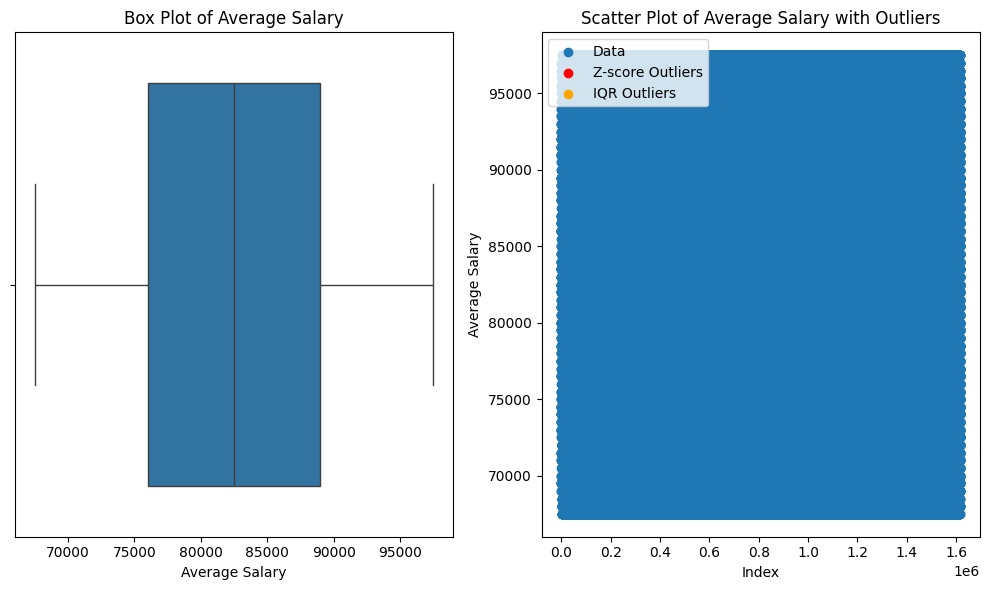

<ipython-input-47-c8a82b098352>:23: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


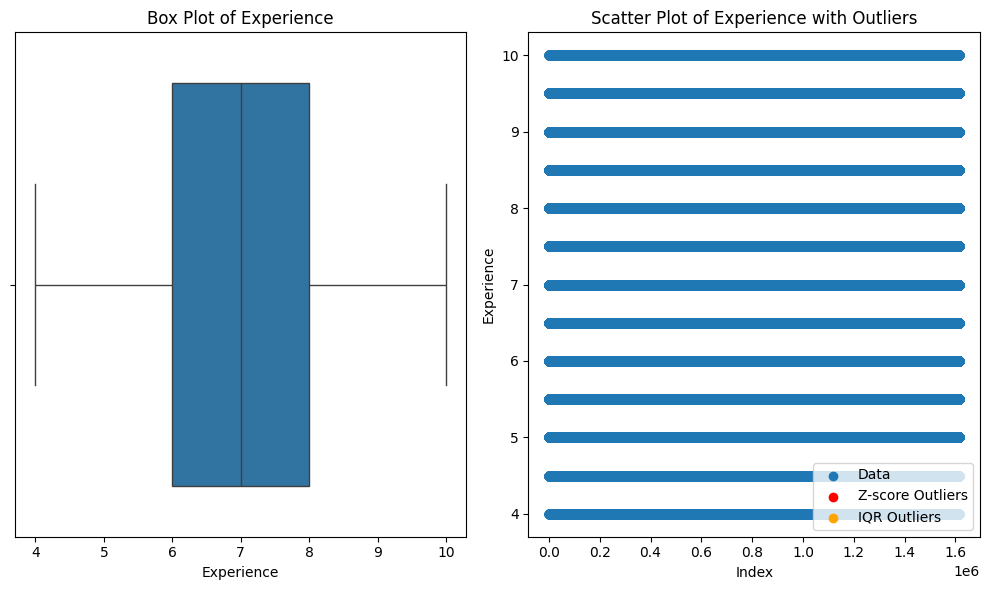

<ipython-input-47-c8a82b098352>:23: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  plt.tight_layout()
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


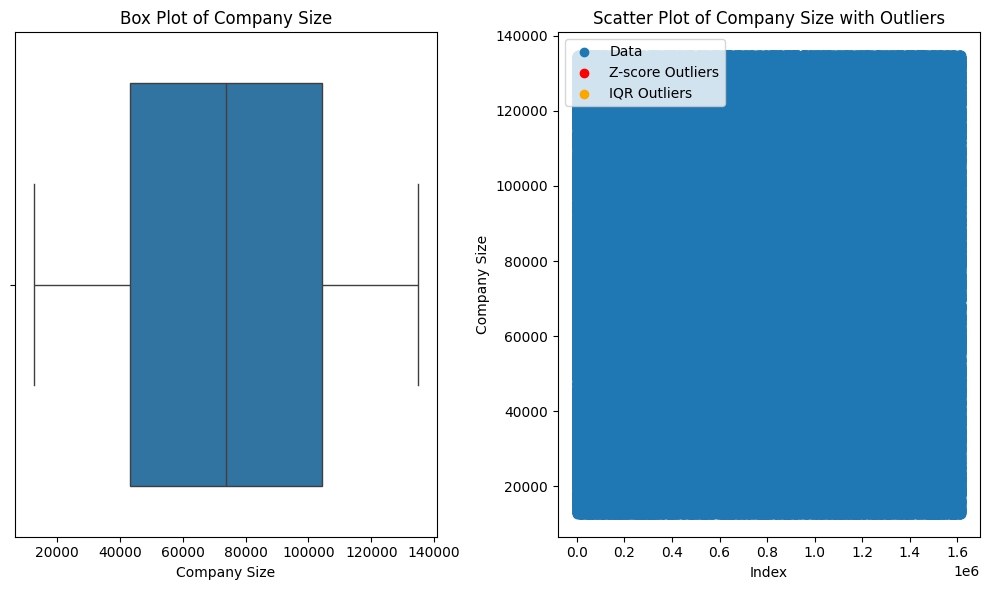

In [ ]:
def visualize_outliers(data, outliers_zscore, outliers_iqr, column_name):

    plt.figure(figsize=(10, 6))

    # Box plot
    plt.subplot(1, 2, 1)
    sns.boxplot(x=data[column_name])
    plt.title(f'Box Plot of {column_name}')

    plt.subplot(1, 2, 2)
    plt.scatter(data.index, data[column_name], label='Data')
    plt.scatter(outliers_zscore.index, outliers_zscore, color='red', label='Z-score Outliers')
    plt.scatter(outliers_iqr.index, outliers_iqr, color='orange', label='IQR Outliers')
    plt.title(f'Scatter Plot of {column_name} with Outliers')
    plt.xlabel('Index')
    plt.ylabel(column_name)
    plt.legend()

    plt.tight_layout()
    plt.show()


numerical_cols = ['Average Salary', 'Experience', 'Company Size']

for col in numerical_cols:
    outliers_zscore = find_outliers_zscore(df[col])
    outliers_iqr = find_outliers_iqr(df[col])
    visualize_outliers(df, outliers_zscore, outliers_iqr, col)

In [ ]:
from sklearn.preprocessing import MinMaxScaler

numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Create a MinMaxScaler object
scaler = MinMaxScaler()

# Fit the scaler to the data and transform it
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

In [ ]:
from sklearn.preprocessing import StandardScaler

numerical_cols = ['Average Salary', 'Experience', 'Company Size']

# Create a StandardScaler object
scaler = StandardScaler()

# Fit the scaler to the data and transform it
df[numerical_cols] = scaler.fit_transform(df[numerical_cols])

In [ ]:
df.head()

,Job Id,Experience,Qualifications,Country,latitude,longitude,Work Type,Company Size,Job Posting Date,Preference,...,Responsibilities,Company,Sector,Industry,Website,CEO,0,Salary Starts From,Salary To,Average Salary
0,1089843540111562,2.100241,M.Tech,Isle of Man,54.2361,-4.5481,Intern,-1.328759,2022-04-24,Female,...,"Manage and grow social media accounts, create ...",Icahn Enterprises,Diversified,Diversified Financials,www.ielp.com,David Willetts,NaN,59000.0,99000.0,-0.463731
1,398454096642776,0.000074,BCA,Turkmenistan,38.9697,59.5563,Intern,0.754566,2022-12-19,Female,...,"Design and code user interfaces for websites, ...",PNC Financial Services Group,Financial Services,Commercial Banks,www.pnc.com,William S. Demchak,NaN,56000.0,116000.0,0.466081
2,481640072963533,-0.699982,PhD,"Macao SAR, China",22.1987,113.5439,Temporary,0.306535,2022-09-14,Male,...,Establish and enforce quality control standard...,United Services Automobile Assn.,Insurance,Insurance: Property and Casualty (Stock),www.usaa.com,Wayne Peacock,NaN,61000.0,104000.0,0.001175
3,688192671473044,0.350101,PhD,Benin,9.3077,2.3158,Full-Time,1.591874,2023-02-25,Female,...,"Design, configure, and optimize wireless netwo...",Hess,Energy,"Mining, Crude-Oil Production",www.hess.com,John B. Hess,NaN,65000.0,91000.0,-0.596561
4,117057806156508,-0.349954,MBA,Chile,-35.6751,-71.5429,Intern,-0.559811,2022-10-11,Female,...,Specialize in conference and convention planni...,Cairn Energy,Energy,Energy - Oil & Gas Exploration & Production,https://www.cairnenergy.com/,Simon Thomson,NaN,64000.0,87000.0,-0.928636


In [ ]:
# Identify columns with all zeros
zero_cols = df.columns[(df == 0).all()]

# Drop the identified columns
df = df.drop(columns=zero_cols)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 27 columns):
 #   Column              Non-Null Count    Dtype   
---  ------              --------------    -----   
 0   Job Id              1615940 non-null  int64   
 1   Experience          1615940 non-null  float64 
 2   Qualifications      1615940 non-null  category
 3   Country             1615940 non-null  object  
 4   latitude            1615940 non-null  float64 
 5   longitude           1615940 non-null  float64 
 6   Work Type           1615940 non-null  category
 7   Company Size        1615940 non-null  float64 
 8   Job Posting Date    1615940 non-null  object  
 9   Preference          1615940 non-null  category
 10  Contact Person      1615940 non-null  object  
 11  Contact             1615940 non-null  object  
 12  Job Title           1615940 non-null  category
 13  Role                1615940 non-null  object  
 14  Job Portal          1615940 non-null  object  
 15

In [ ]:
#save


file_path = '/content/drive/MyDrive/datasets/processed_job_descriptions.csv'

# Save the DataFrame to the specified path
df.to_csv(file_path, index=False)

##Exploratory Data Analysis (EDA)

○ Use descriptive statistics (e.g., mean, median, standard deviation) to summarize the dataset.

○ Create visualizations (e.g., histograms, scatter plots, box plots) to identify patterns, trends, and relationships.

○ Identify potential issues such as multicollinearity or skewed distributions using correlation analysis and statistical tests.

In [ ]:
#1. top 50 jobs
top_50_jobs = df['Job Title'].value_counts().nlargest(50).index  # Get top 50 job titles
filtered_df = df[df['Job Title'].isin(top_50_jobs)]  # Filter DataFrame

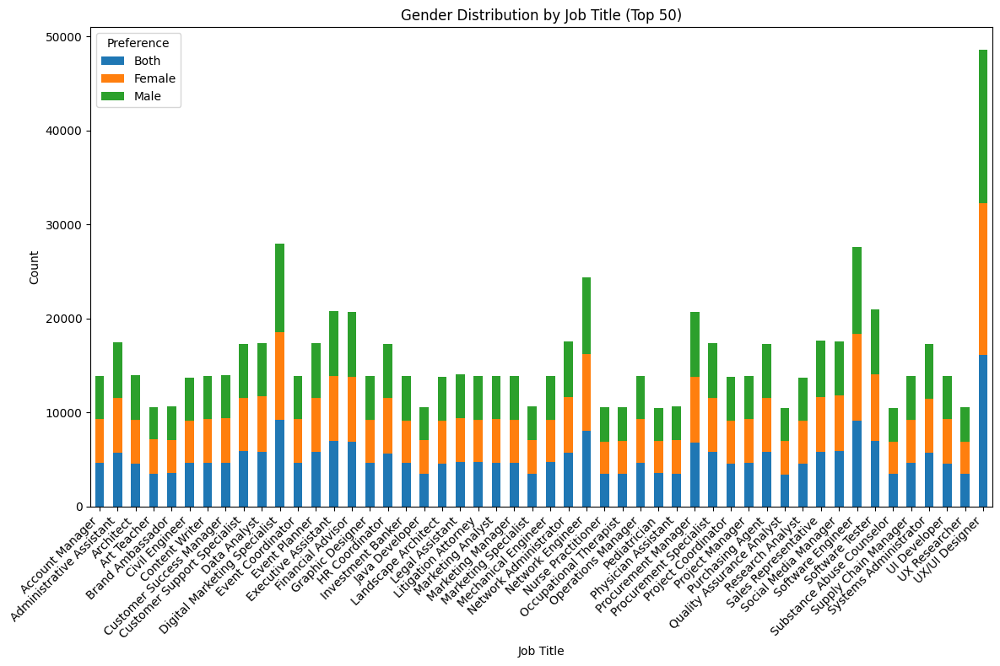

In [ ]:
gender_job_distribution = pd.crosstab(filtered_df['Job Title'], filtered_df['Preference'])

# Visualize with a stacked bar chart
gender_job_distribution.plot(kind='bar', stacked=True, figsize=(12, 8))  # Adjust figsize for better readability
plt.title('Gender Distribution by Job Title (Top 50)')
plt.xlabel('Job Title')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
plt.legend(title='Preference')
plt.tight_layout()
plt.show()

In [ ]:
# Top job titles for women (within top 50)
top_female_jobs = gender_job_distribution['Female'].sort_values(ascending=False)[:10]  # Top 10 within top 50
print("Top Job Titles for Women (Top 50):\n", top_female_jobs)

# Top job titles for men (within top 50)
top_male_jobs = gender_job_distribution['Male'].sort_values(ascending=False)[:10]  # Top 10 within top 50
print("\nTop Job Titles for Men (Top 50):\n", top_male_jobs)

Top Job Titles for Women (Top 50):
 Job Title
UX/UI Designer                  16154
Digital Marketing Specialist     9313
Software Engineer                9278
Network Engineer                 8157
Software Tester                  7096
Procurement Manager              6980
Executive Assistant              6918
Financial Advisor                6866
Social Media Manager             5921
Data Analyst                     5917
Name: Female, dtype: int64

Top Job Titles for Men (Top 50):
 Job Title
UX/UI Designer                  16241
Digital Marketing Specialist     9389
Software Engineer                9230
Network Engineer                 8166
Financial Advisor                6920
Procurement Manager              6907
Executive Assistant              6863
Software Tester                  6845
Sales Representative             5982
Administrative Assistant         5927
Name: Male, dtype: int64


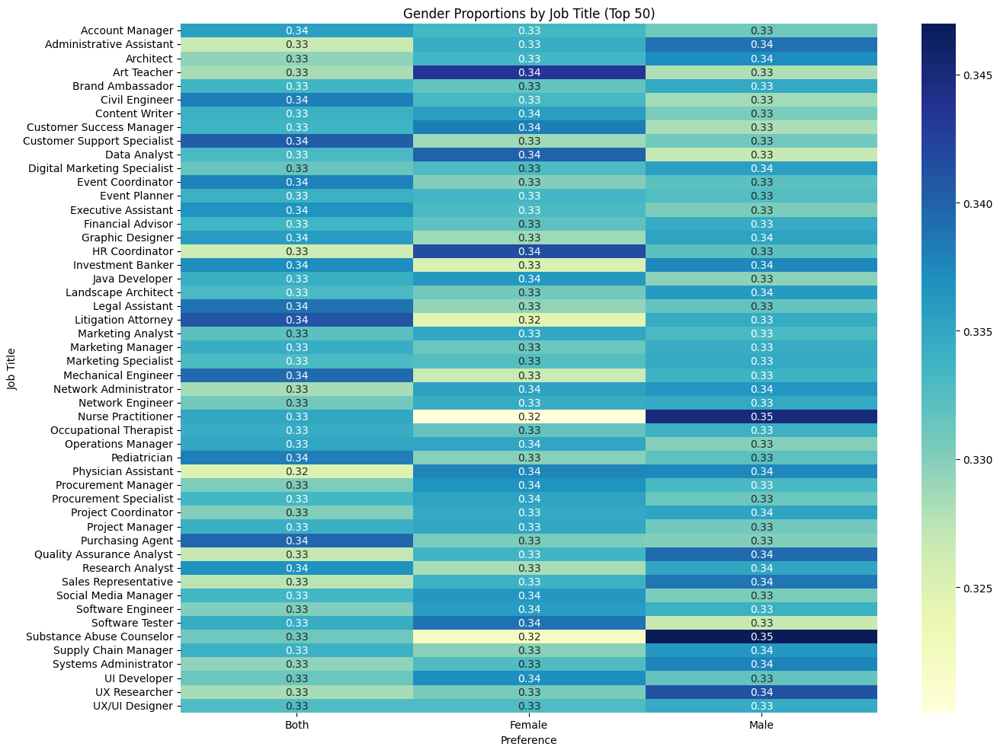

In [ ]:
# Calculate proportions
gender_job_proportions = gender_job_distribution.div(gender_job_distribution.sum(axis=1), axis=0)

# Visualize with a heatmap
plt.figure(figsize=(14, 10))  # Adjust figsize for better readability
sns.heatmap(gender_job_proportions, annot=True, cmap='YlGnBu', fmt=".2f")
plt.title('Gender Proportions by Job Title (Top 50)')
plt.xlabel('Preference')
plt.ylabel('Job Title')
plt.tight_layout()
plt.show()

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12]),
 [Text(0, 0, '-2.1000932897599522'),
  Text(1, 0, '-1.7500654669329432'),
  Text(2, 0, '-1.4000376441059348'),
  Text(3, 0, '-1.0500098212789257'),
  Text(4, 0, '-0.6999819984519169'),
  Text(5, 0, '-0.3499541756249084'),
  Text(6, 0, '7.364720210006288e-05'),
  Text(7, 0, '0.35010147002910946'),
  Text(8, 0, '0.7001292928561179'),
  Text(9, 0, '1.0501571156831264'),
  Text(10, 0, '1.4001849385101357'),
  Text(11, 0, '1.750212761337144'),
  Text(12, 0, '2.100240584164153')])

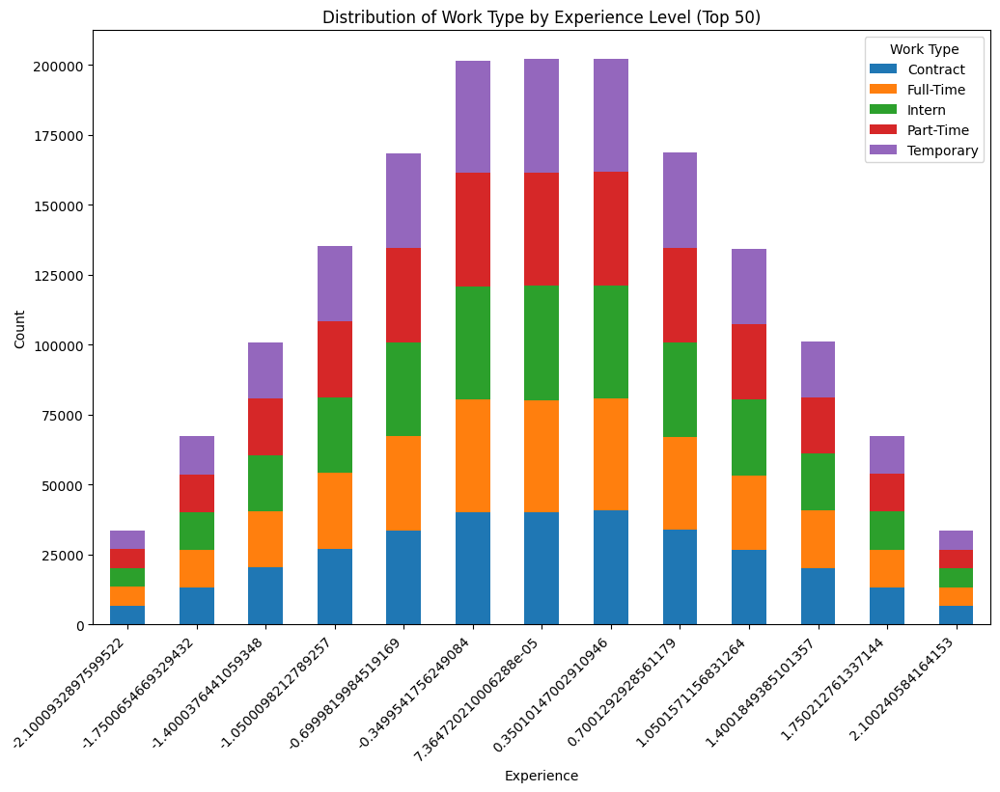

In [ ]:

# 1. Get top 50 experience levels
top_50_experiences = df['Experience'].value_counts().nlargest(50).index
filtered_df = df[df['Experience'].isin(top_50_experiences)]

# 2. Create crosstab for top 50 experiences
experience_work_type = pd.crosstab(filtered_df['Experience'], filtered_df['Work Type'])

# 3. Visualize with a stacked bar chart
experience_work_type.plot(kind='bar', stacked=True, figsize=(12, 8))  # Adjust figsize for better readability
plt.title('Distribution of Work Type by Experience Level (Top 50)')
plt.xlabel('Experience')
plt.ylabel('Count')
plt.xticks(rotation=45, ha='right')

In [ ]:
#since the ram crashed, i saved the processed csv separately and ran it for visualizations
from google.colab import drive
drive.mount('/content/drive')


file_path = '/content/drive/MyDrive/datasets/1/processed_job_descriptions.csv'
df = pd.read_csv(file_path)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


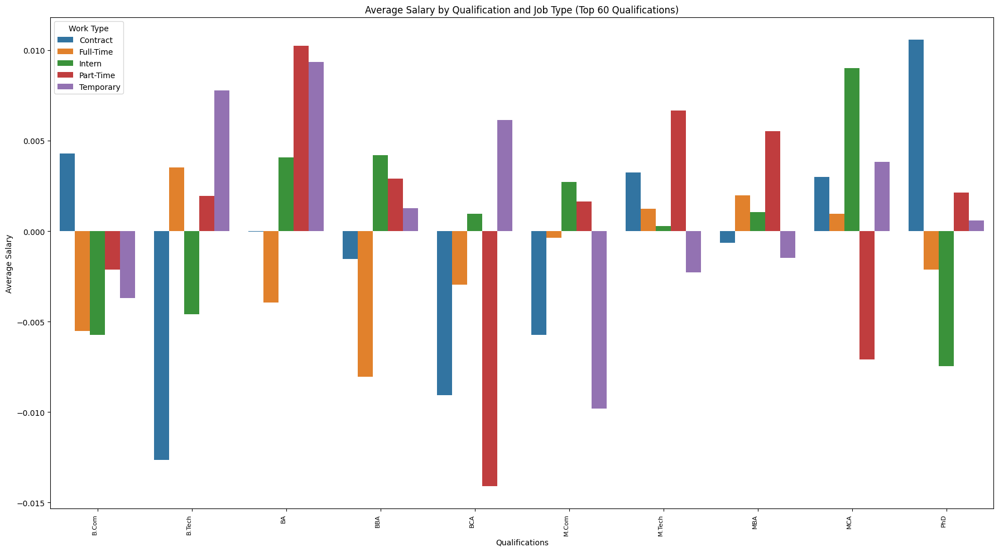

<ipython-input-4-edc013b9c4f2>:28: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  qualification_job_salary_pivot = qualification_job_salary.pivot("Qualifications", "Work Type", "Average Salary")
<ipython-input-4-edc013b9c4f2>:35: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend(title='Work Type')


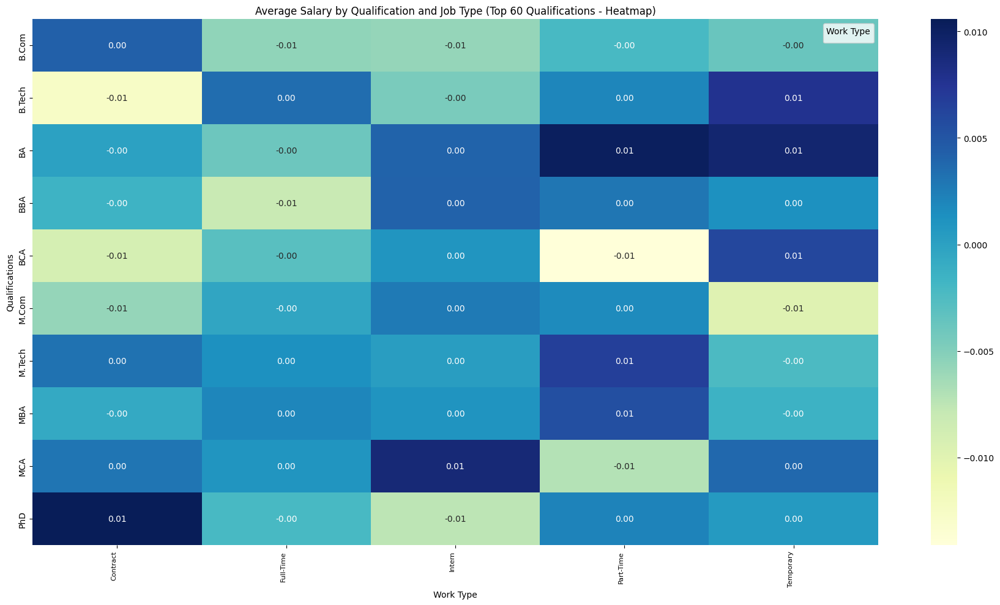

In [ ]:

# Get top 60 qualifications
top_60_qualifications = df['Qualifications'].value_counts().nlargest(60).index

# Filter DataFrame for top 60 qualifications
filtered_df = df[df['Qualifications'].isin(top_60_qualifications)]

# Group data by qualifications and job type, calculating average salary
qualification_job_salary = filtered_df.groupby(['Qualifications', 'Work Type'])['Average Salary'].mean().reset_index()


plt.figure(figsize=(18, 10))
sns.barplot(x='Qualifications', y='Average Salary', hue='Work Type', data=qualification_job_salary)
plt.title('Average Salary by Qualification and Job Type (Top 60 Qualifications)')
plt.xlabel('Qualifications')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.legend(title='Work Type')
plt.tight_layout()
plt.show()


qualification_job_salary_pivot = qualification_job_salary.pivot("Qualifications", "Work Type", "Average Salary")
plt.figure(figsize=(18, 10))
sns.heatmap(qualification_job_salary_pivot, annot=True, cmap='YlGnBu', fmt=".2f")
plt.title('Average Salary by Qualification and Job Type (Top 60 Qualifications - Heatmap)')
plt.xlabel('Work Type')
plt.ylabel('Qualifications')
plt.xticks(rotation=90, ha='right', fontsize=8)  # Rotate and adjust font size for x-axis labels
plt.legend(title='Work Type')
plt.tight_layout()
plt.show()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1615940 entries, 0 to 1615939
Data columns (total 27 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   Job Id              1615940 non-null  int64  
 1   Experience          1615940 non-null  float64
 2   Qualifications      1615940 non-null  object 
 3   Country             1615940 non-null  object 
 4   latitude            1615940 non-null  float64
 5   longitude           1615940 non-null  float64
 6   Work Type           1615940 non-null  object 
 7   Company Size        1615940 non-null  float64
 8   Job Posting Date    1615940 non-null  object 
 9   Preference          1615940 non-null  object 
 10  Contact Person      1615940 non-null  object 
 11  Contact             1615940 non-null  object 
 12  Job Title           1615940 non-null  object 
 13  Role                1615940 non-null  object 
 14  Job Portal          1615940 non-null  object 
 15  Job Description

In [ ]:

# Get top 60 job titles by average salary
top_60_jobs = df.groupby('Job Title')['Average Salary'].mean().nlargest(60).index

# Filter DataFrame for top 60 job titles
filtered_df = df[df['Job Title'].isin(top_60_jobs)]


job_location_salary = filtered_df.groupby(['Job Title', 'Country'])['Average Salary'].agg(['mean', 'count']).reset_index()

# Sort by average salary in descending order
job_location_salary = job_location_salary.sort_values(by=['mean'], ascending=False)

# Display the top job titles, locations, average salaries, and job counts
print(job_location_salary[['Job Title', 'Country', 'mean', 'count']])

                  Job Title                    Country      mean  count
5289    Key Account Manager                    Lao PDR  0.941204     13
3136          Event Manager                  Lithuania  0.855716     15
12054  Supply Chain Analyst            Solomon Islands  0.804797     10
5300    Key Account Manager                 Madagascar  0.798156     14
8801     Personal Assistant                     Rwanda  0.793728     15
...                     ...                        ...       ...    ...
5270    Key Account Manager                    Iceland -0.682900     10
10857       Sales Associate                El Salvador -0.711278     11
10971       Sales Associate  Sint Maarten (Dutch part) -0.745995     12
3156          Event Manager                 Mozambique -0.783156     21
3052          Event Manager                     Brunei -0.808259     16

[12960 rows x 4 columns]


<ipython-input-9-14698874d74d>:10: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


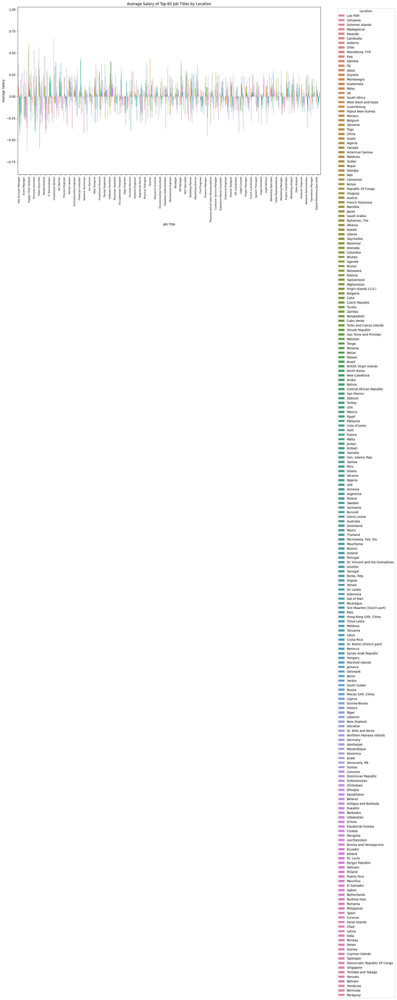

In [ ]:
#visualize

plt.figure(figsize=(18, 10))  # Adjust figure size for better readability
sns.barplot(x='Job Title', y='mean', hue='Country', data=job_location_salary) # Changed hue to 'Country'
plt.title('Average Salary of Top 60 Job Titles by Location')
plt.xlabel('Job Title')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)  # Rotate and adjust font size for x-axis labels
plt.legend(title='Location', bbox_to_anchor=(1.05, 1), loc='upper left') # Place legend outside the plot
plt.tight_layout()
plt.show()

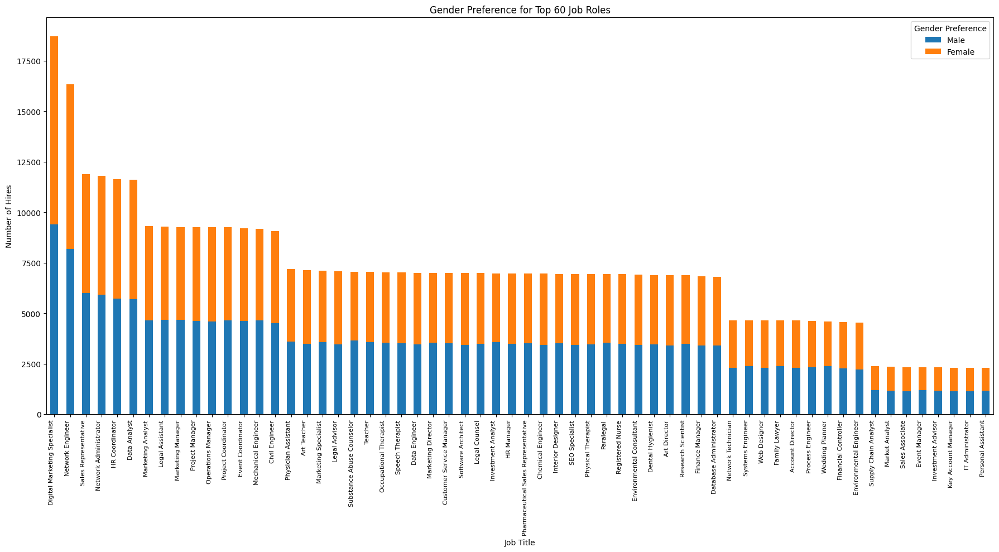

In [ ]:

top_60_jobs = df.groupby('Job Title')['Average Salary'].mean().nlargest(60).index

# Filter DataFrame for top 60 job titles
filtered_df = df[df['Job Title'].isin(top_60_jobs)]

# Create a crosstab to count gender preferences for each job title
gender_job_distribution = pd.crosstab(filtered_df['Job Title'], filtered_df['Preference'])

# Filter for 'Male' and 'Female' preferences only
gender_job_distribution = gender_job_distribution[['Male', 'Female']]

# Sort by total hires (Male + Female) in descending order
gender_job_distribution['Total'] = gender_job_distribution['Male'] + gender_job_distribution['Female']
gender_job_distribution = gender_job_distribution.sort_values(by=['Total'], ascending=False)

# Visualize with a stacked bar chart
gender_job_distribution[['Male', 'Female']].plot(kind='bar', stacked=True, figsize=(18, 10))
plt.title('Gender Preference for Top 60 Job Roles')
plt.xlabel('Job Title')
plt.ylabel('Number of Hires')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.legend(title='Gender Preference')
plt.tight_layout()
plt.show()

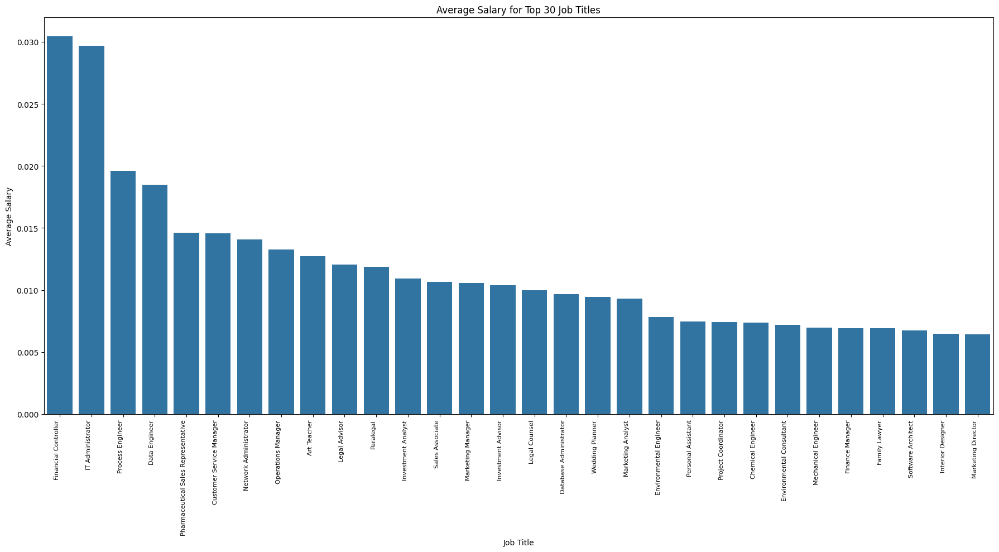

In [ ]:

job_salary = df.groupby('Job Title')['Average Salary'].mean().reset_index()

# Sort by average salary in descending order
job_salary = job_salary.sort_values(by=['Average Salary'], ascending=False)

# Select top 30 job titles
top_30_jobs = job_salary.head(30)

# Create a bar plot
plt.figure(figsize=(18, 10))
sns.barplot(x='Job Title', y='Average Salary', data=top_30_jobs)
plt.title('Average Salary for Top 30 Job Titles')
plt.xlabel('Job Title')
plt.ylabel('Average Salary')
plt.xticks(rotation=90, ha='right', fontsize=8)
plt.tight_layout()
plt.show()

<ipython-input-15-32dab6b74f48>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  subset['Year'] = subset['Year'].astype(int)  # or subset['Year'] = subset['Year'].astype(str) for categorical
<ipython-input-15-32dab6b74f48>:29: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()  # Adjust layout to prevent overlapping


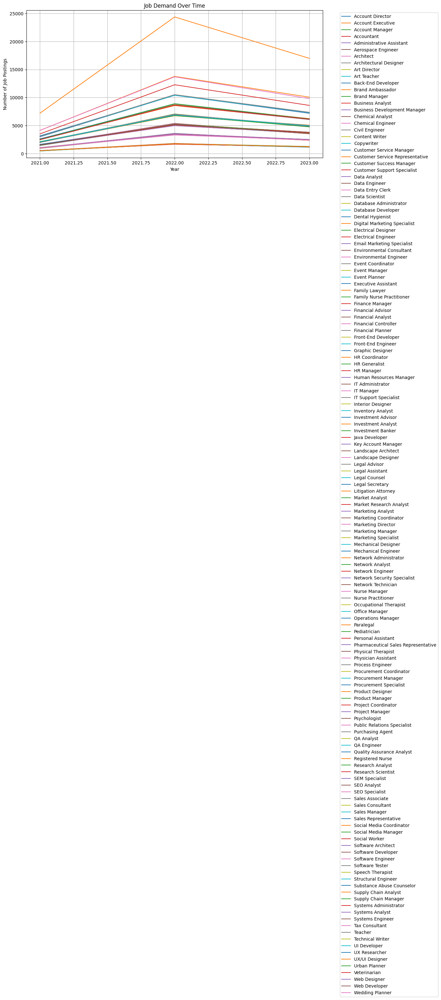

In [ ]:

df['Year'] = pd.to_datetime(df['Job Posting Date']).dt.year  # Assuming 'Date' is in a format pandas can understand

# Group by Job Title and Year, and count occurrences
job_demand_over_time = df.groupby(['Job Title', 'Year'])['Job Title'].count().reset_index(name='Count')

# Visualize with a line plot
plt.figure(figsize=(12, 6))
for job_title in job_demand_over_time['Job Title'].unique():
    subset = job_demand_over_time[job_demand_over_time['Job Title'] == job_title]
    subset['Year'] = subset['Year'].astype(int)

    plt.plot(subset['Year'], subset['Count'], label=job_title)

plt.title('Job Demand Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Job Postings')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')

plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
!pip install plotly
import pandas as pd
import plotly.express as px


# 1. Get top 50 job titles
top_50_jobs = df['Job Title'].value_counts().nlargest(50).index
filtered_df = df[df['Job Title'].isin(top_50_jobs)]

# 2. Create a scatter mapbox using plotly.express
fig = px.scatter_mapbox(
    filtered_df,
    lat="latitude",
    lon="longitude",
    color="Job Title",
    hover_name="Job Title",
    zoom=1,
    height=600,
    width=800,
    mapbox_style="open-street-map"
)

fig.update_layout(title_text="Geographical Spread of Top 50 Job Titles")
fig.show()

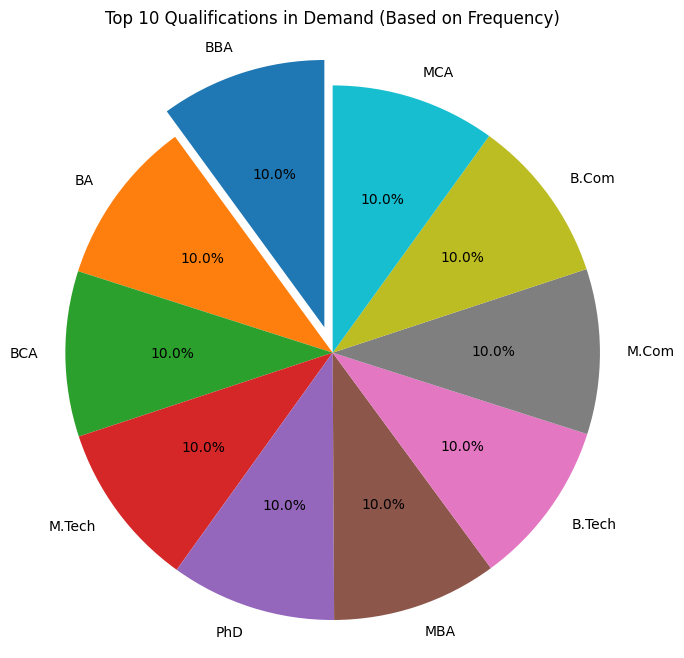

In [29]:

# 1. Get top 10 qualifications and mode
top_10_qualifications = df['Qualifications'].value_counts().nlargest(10)
mode_qualification = top_10_qualifications.index[0]

# 2. Create explode array for highlighting the mode
explode = np.zeros(len(top_10_qualifications))
explode[top_10_qualifications.index.get_loc(mode_qualification)] = 0.1

# 3. Create the pie chart with proportional slices
plt.figure(figsize=(8, 8))
plt.pie(top_10_qualifications, labels=top_10_qualifications.index, autopct='%1.1f%%', startangle=90, explode=explode)
plt.title('Top 10 Qualifications in Demand (Based on Frequency)')
plt.axis('equal')
plt.show()

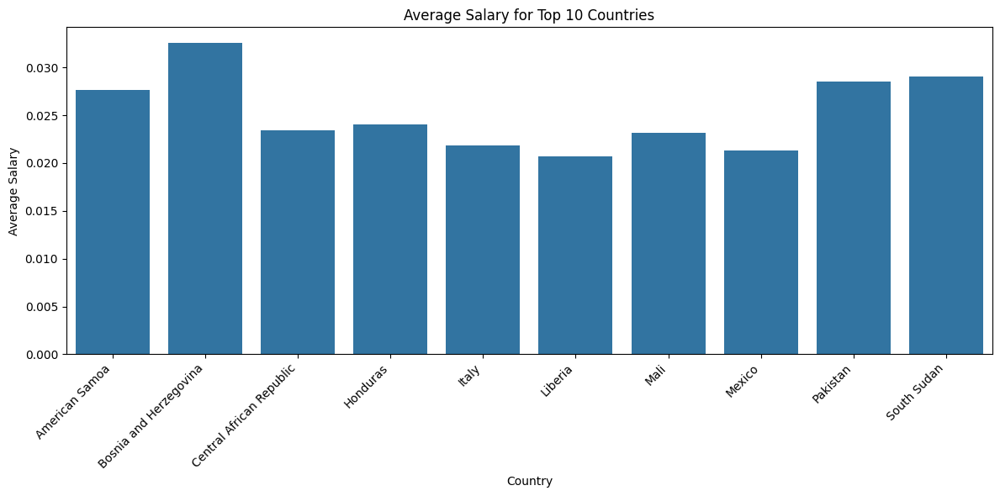

In [23]:
top_10_countries = df.groupby('Country')['Average Salary'].mean().nlargest(10).index
filtered_df = df[df['Country'].isin(top_10_countries)]

# Group by country and average salary
country_salary = filtered_df.groupby(['Country'])['Average Salary'].mean().reset_index()

# Create the bar plot using seaborn
plt.figure(figsize=(12, 6))
sns.barplot(x='Country', y='Average Salary', data=country_salary)
plt.title('Average Salary for Top 10 Countries')
plt.xlabel('Country')
plt.ylabel('Average Salary')
plt.xticks(rotation=45, ha='right', fontsize=10)
plt.tight_layout()
plt.show()

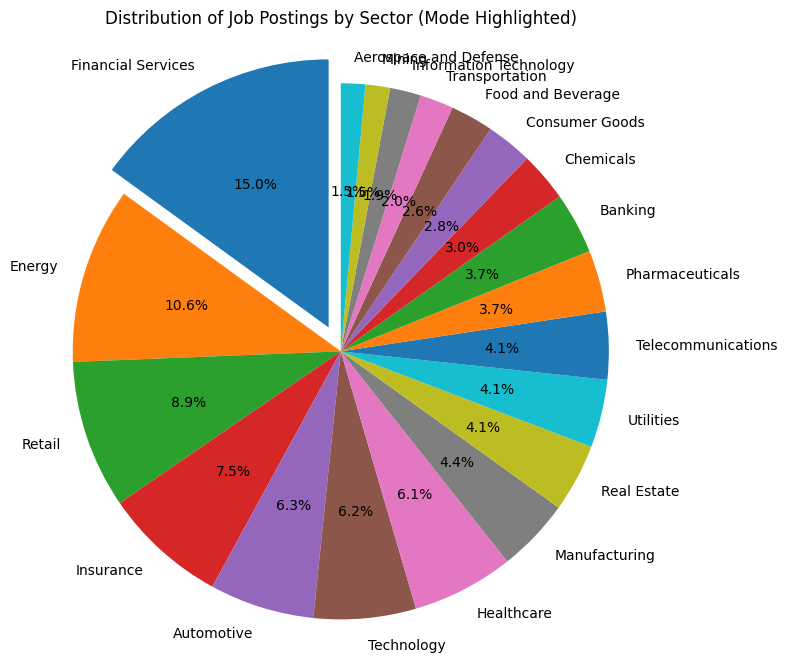

In [28]:
import numpy as np
import matplotlib.pyplot as plt

# 1. Get sector distribution and mode
sector_distribution = df['Sector'].value_counts().nlargest(20)
mode_sector = sector_distribution.index[0]  # Get the most frequent sector (mode)

# 2. Create explode array for highlighting the mode
explode = np.zeros(len(sector_distribution))  # Create an array of zeros
explode[sector_distribution.index.get_loc(mode_sector)] = 0.1

# 3. Create the pie chart
plt.figure(figsize=(8, 8))
plt.pie(sector_distribution, labels=sector_distribution.index, autopct='%1.1f%%', startangle=90, explode=explode)
plt.title('Distribution of Job Postings by Sector (Mode Highlighted)')
plt.axis('equal')
plt.show()